# Clustering -  Kmeans

### Data prepatation - Group Transacton Data

Grouping transaction data in order to get the number on every item that has been sold

In [2]:
import sys, warnings, time, os, copy, gc, re, random, pickle
warnings.filterwarnings('ignore')
from IPython.display import display
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# pd.set_option('display.max_rows', 50)
# pd.set_option('display.max_columns', None)
# pd.set_option("display.max_colwidth", 10000)
import seaborn as sns
sns.set()
from pandas.io.json import json_normalize
from pprint import pprint
from pathlib import Path
from tqdm import tqdm
tqdm.pandas()
from collections import Counter
from datetime import datetime, timedelta
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.decomposition import PCA
import plotly.express as px
from sklearn.metrics import mean_squared_error as MSE
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.ensemble import GradientBoostingClassifier
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import precision_score, recall_score
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")

In [3]:
articles = pd.read_csv('articles.csv')
customers = pd.read_csv('customers.csv')
transtrain = pd.read_csv('transactions_train.csv')

In [4]:
# select 3 columns from transaction data - date, customer_id and article_id
transtrain_n = transtrain[['t_dat','customer_id','article_id']]
transtrain_n = transtrain.loc[(transtrain['t_dat'] >= '2019-09-22')
                     & (transtrain['t_dat'] < '2020-09-22')]

In [5]:
# transtrain_n=transtrain_n.iloc[:10000]

In [6]:
print(transtrain_n.shape)
transtrain_n.head()

(14899507, 5)


,t_dat,customer_id,article_id,price,sales_channel_id
16855951,2019-09-22,000fb6e772c5d0023892065e659963da90b1866035558e...,695632095,0.033881,2
16855952,2019-09-22,0014b19aa47d031d859ae8d8f776524cdd35349db69d64...,787648001,0.016932,2
16855953,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,767496001,0.015237,1
16855954,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,766826002,0.050831,1
16855955,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,655710010,0.050831,1


In [7]:
# set a sub table call product_bought_times  
product_bought_times = transtrain_n.groupby(['customer_id','article_id'])['t_dat'].agg('count').reset_index()
product_bought_times.columns = ['customer_id','article_id','ct']
product_bought_times.tail()

,customer_id,article_id,ct
12878150,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,821395003,1
12878151,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,840360003,1
12878152,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,866755002,2
12878153,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,882810001,1
12878154,ffffd9ac14e89946416d80e791d064701994755c3ab686...,806050001,1


In [8]:
# Merge transaction train table merge on product_bought_time table on customer_id and article_id 
transtrain_n = transtrain_n.merge(product_bought_times,on=['customer_id','article_id'],how='left')
transtrain_n  = transtrain_n.sort_values(['ct','t_dat'],ascending=False)
transtrain_n  = transtrain_n.drop_duplicates(['customer_id','article_id'])
transtrain_n  = transtrain_n.sort_values(['ct','t_dat'],ascending=False)
transtrain_n.tail()

,t_dat,customer_id,article_id,price,sales_channel_id,ct
33944,2019-09-22,ffe8f09992a6e188390e34872208dd23ebb6425957cc64...,772829002,0.133102,2,1
33945,2019-09-22,fff88e9edfb6987b82fad36c1270082bc101be633efd0a...,817869001,0.025407,2,1
33947,2019-09-22,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,715624036,0.025407,2,1
33948,2019-09-22,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,456163051,0.033881,2,1
33949,2019-09-22,fffcd556af797bddc25d6d56600b6e298a19b90624a8ee...,773989001,0.050831,2,1


In [9]:
# Check transtrain data type
transtrain_n.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12878155 entries, 291434 to 33949
Data columns (total 6 columns):
 #   Column            Dtype  
---  ------            -----  
 0   t_dat             object 
 1   customer_id       object 
 2   article_id        int64  
 3   price             float64
 4   sales_channel_id  int64  
 5   ct                int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 687.8+ MB


In [10]:
# transfer t_date from data frame object to date_time pd series
transtrain_n['t_dat'] = pd.to_datetime(transtrain_n['t_dat'], errors='coerce')

In [11]:
# transfer t_dat columns seperated down to year, month, day
# utilize pd.series_dt to aggregate to day of week, day of year 
# Drop the t_dat in the end since we seperate down all the columns
transtrain_n['year'] = transtrain_n['t_dat'].dt.year
transtrain_n['month'] = transtrain_n['t_dat'].dt.month
transtrain_n['day'] = transtrain_n['t_dat'].dt.day
transtrain_n['dayofweek'] = transtrain_n['t_dat'].dt.dayofweek
transtrain_n['dayofyear'] = transtrain_n['t_dat'].dt.dayofyear
transtrain_n['is_month_end'] = transtrain_n['t_dat'].dt.is_month_end
transtrain_n['is_month_start'] = transtrain_n['t_dat'].dt.is_month_start
transtrain_n.drop(columns=['t_dat'], inplace = True)

transtrain_n.tail()

,customer_id,article_id,price,sales_channel_id,ct,year,month,day,dayofweek,dayofyear,is_month_end,is_month_start
33944,ffe8f09992a6e188390e34872208dd23ebb6425957cc64...,772829002,0.133102,2,1,2019,9,22,6,265,False,False
33945,fff88e9edfb6987b82fad36c1270082bc101be633efd0a...,817869001,0.025407,2,1,2019,9,22,6,265,False,False
33947,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,715624036,0.025407,2,1,2019,9,22,6,265,False,False
33948,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,456163051,0.033881,2,1,2019,9,22,6,265,False,False
33949,fffcd556af797bddc25d6d56600b6e298a19b90624a8ee...,773989001,0.050831,2,1,2019,9,22,6,265,False,False


In [12]:
# Turn customer_id to category data type 
# use pd.series.cat.codes function to give every customer an unique category code
# save it as customer_category_df
transtrain_n['customer_category']= transtrain_n['customer_id'].astype('category')
transtrain_n['category_codes'] = transtrain_n['customer_category'].cat.codes 
customer_category_df = transtrain_n[['customer_id', 'customer_category', 'category_codes']] #save them to put them back together later
print(customer_category_df.dtypes)
customer_category_df.head()

customer_id            object
customer_category    category
category_codes          int32
dtype: object


,customer_id,customer_category,category_codes
291434,5cba04ed9a3759bc02a8a9e01efccc07ce76c35c1a70dc...,5cba04ed9a3759bc02a8a9e01efccc07ce76c35c1a70dc...,359965
1102353,0152964ef19824d631d28ee3327a010fbfc528cdaf5bf0...,0152964ef19824d631d28ee3327a010fbfc528cdaf5bf0...,5115
5266610,c163adbcac6e42e600224be5e1682a5b840e1d430c443a...,c163adbcac6e42e600224be5e1682a5b840e1d430c443a...,750667
6240939,1472c551f2c04873edddc853e214a033692b2b1d6ae2bb...,1472c551f2c04873edddc853e214a033692b2b1d6ae2bb...,79474
11819500,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,548908


In [13]:
# As we have create a table for customer_category, we can drop the two column[customer_category & catrgory_codes] in transtrain
transtrain_n.drop(columns=['customer_category', 'category_codes'], inplace = True)
transtrain_n.dtypes

customer_id          object
article_id            int64
price               float64
sales_channel_id      int64
ct                    int64
year                  int64
month                 int64
day                   int64
dayofweek             int64
dayofyear             int64
is_month_end           bool
is_month_start         bool
dtype: object

In [14]:
transtrain_n.head(100)

,customer_id,article_id,price,sales_channel_id,ct,year,month,day,dayofweek,dayofyear,is_month_end,is_month_start
291434,5cba04ed9a3759bc02a8a9e01efccc07ce76c35c1a70dc...,688558002,0.013661,2,166,2019,9,28,5,271,False,False
1102353,0152964ef19824d631d28ee3327a010fbfc528cdaf5bf0...,756322001,0.025407,2,120,2019,10,16,2,289,False,False
5266610,c163adbcac6e42e600224be5e1682a5b840e1d430c443a...,689365047,0.025407,2,114,2020,2,7,4,38,False,False
6240939,1472c551f2c04873edddc853e214a033692b2b1d6ae2bb...,852521001,0.033881,2,81,2020,3,6,4,66,False,False
11819500,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,685813001,0.016932,2,80,2020,7,6,0,188,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
12070758,5ca3ee4e37e890b9d4b02634e88764e0d0afaf3f307c90...,850244003,0.004220,2,33,2020,7,12,6,194,False,False
8695904,889c0024f433bf9650c7722bc30d1325d8ac32b5f58dfb...,610776103,0.007627,2,33,2020,5,9,5,130,False,False
5952065,ee42e277c04eadd88e43ea3346e041a62408f24d45fb49...,610776002,0.008458,2,33,2020,2,27,3,58,False,False
5449849,434a47e794754b99fc80059a579b59c5f15ab606eabea5...,717490008,0.008458,2,33,2020,2,13,3,44,False,False


## Merging articles with ct columns from transaction data as one of the kmeans feature

In [15]:
# Drop articles columns on detail description
articles.drop(columns=['detail_desc'], inplace = True)
articles

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_no,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name
0,108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,1676,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic
1,108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,1676,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic
2,108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,1676,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic
3,110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,1339,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear"
4,110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,1339,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105537,953450001,953450,5pk regular Placement1,302,Socks,Socks & Tights,1010014,Placement print,9,Black,...,7188,Socks Bin,F,Menswear,3,Menswear,26,Men Underwear,1021,Socks and Tights
105538,953763001,953763,SPORT Malaga tank,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,1919,Jersey,A,Ladieswear,1,Ladieswear,2,H&M+,1005,Jersey Fancy
105539,956217002,956217,Cartwheel dress,265,Dress,Garment Full body,1010016,Solid,9,Black,...,1641,Jersey,A,Ladieswear,1,Ladieswear,18,Womens Trend,1005,Jersey Fancy
105540,957375001,957375,CLAIRE HAIR CLAW,72,Hair clip,Accessories,1010016,Solid,9,Black,...,3946,Small Accessories,D,Divided,2,Divided,52,Divided Accessories,1019,Accessories


In [16]:
# articles=articles.iloc[:10000]
# articles

In [17]:
articles.shape

(105542, 24)

In [18]:
# Show article data types - two category
articles.dtypes

article_id                       int64
product_code                     int64
prod_name                       object
product_type_no                  int64
product_type_name               object
product_group_name              object
graphical_appearance_no          int64
graphical_appearance_name       object
colour_group_code                int64
colour_group_name               object
perceived_colour_value_id        int64
perceived_colour_value_name     object
perceived_colour_master_id       int64
perceived_colour_master_name    object
department_no                    int64
department_name                 object
index_code                      object
index_name                      object
index_group_no                   int64
index_group_name                object
section_no                       int64
section_name                    object
garment_group_no                 int64
garment_group_name              object
dtype: object

In [19]:
# create a table called time_bought 
times_bought = transtrain_n[['article_id', 'ct']]
times_bought = times_bought.groupby('article_id', as_index = False).sum()
times_bought.head()

,article_id,ct
0,108775015,103
1,108775044,423
2,110065001,155
3,110065002,65
4,110065011,100


In [20]:
#
articles = articles.merge(times_bought,  how='left', on='article_id')
articles['ct'] = articles['ct'].fillna(0)
articles.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct
0,108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,103.0
1,108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,423.0
2,108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,0.0
3,110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear",155.0
4,110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear",65.0


In [21]:
#kmeans can't handle integers, so convert to float
int64s = articles.select_dtypes(include=['int64']).columns
for i in int64s:
    articles[i] = articles[i].astype(float)

In [22]:
articles

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct
0,108775015.0,108775.0,Strap top,253.0,Vest top,Garment Upper body,1010016.0,Solid,9.0,Black,...,Jersey Basic,A,Ladieswear,1.0,Ladieswear,16.0,Womens Everyday Basics,1002.0,Jersey Basic,103.0
1,108775044.0,108775.0,Strap top,253.0,Vest top,Garment Upper body,1010016.0,Solid,10.0,White,...,Jersey Basic,A,Ladieswear,1.0,Ladieswear,16.0,Womens Everyday Basics,1002.0,Jersey Basic,423.0
2,108775051.0,108775.0,Strap top (1),253.0,Vest top,Garment Upper body,1010017.0,Stripe,11.0,Off White,...,Jersey Basic,A,Ladieswear,1.0,Ladieswear,16.0,Womens Everyday Basics,1002.0,Jersey Basic,0.0
3,110065001.0,110065.0,OP T-shirt (Idro),306.0,Bra,Underwear,1010016.0,Solid,9.0,Black,...,Clean Lingerie,B,Lingeries/Tights,1.0,Ladieswear,61.0,Womens Lingerie,1017.0,"Under-, Nightwear",155.0
4,110065002.0,110065.0,OP T-shirt (Idro),306.0,Bra,Underwear,1010016.0,Solid,10.0,White,...,Clean Lingerie,B,Lingeries/Tights,1.0,Ladieswear,61.0,Womens Lingerie,1017.0,"Under-, Nightwear",65.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105537,953450001.0,953450.0,5pk regular Placement1,302.0,Socks,Socks & Tights,1010014.0,Placement print,9.0,Black,...,Socks Bin,F,Menswear,3.0,Menswear,26.0,Men Underwear,1021.0,Socks and Tights,16.0
105538,953763001.0,953763.0,SPORT Malaga tank,253.0,Vest top,Garment Upper body,1010016.0,Solid,9.0,Black,...,Jersey,A,Ladieswear,1.0,Ladieswear,2.0,H&M+,1005.0,Jersey Fancy,34.0
105539,956217002.0,956217.0,Cartwheel dress,265.0,Dress,Garment Full body,1010016.0,Solid,9.0,Black,...,Jersey,A,Ladieswear,1.0,Ladieswear,18.0,Womens Trend,1005.0,Jersey Fancy,21.0
105540,957375001.0,957375.0,CLAIRE HAIR CLAW,72.0,Hair clip,Accessories,1010016.0,Solid,9.0,Black,...,Small Accessories,D,Divided,2.0,Divided,52.0,Divided Accessories,1019.0,Accessories,0.0


In [23]:
articles.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 105542 entries, 0 to 105541
Data columns (total 25 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   article_id                    105542 non-null  float64
 1   product_code                  105542 non-null  float64
 2   prod_name                     105542 non-null  object 
 3   product_type_no               105542 non-null  float64
 4   product_type_name             105542 non-null  object 
 5   product_group_name            105542 non-null  object 
 6   graphical_appearance_no       105542 non-null  float64
 7   graphical_appearance_name     105542 non-null  object 
 8   colour_group_code             105542 non-null  float64
 9   colour_group_name             105542 non-null  object 
 10  perceived_colour_value_id     105542 non-null  float64
 11  perceived_colour_value_name   105542 non-null  object 
 12  perceived_colour_master_id    105542 non-nul

In [24]:
articles.select_dtypes(include=['object']).columns

Index(['prod_name', 'product_type_name', 'product_group_name',
       'graphical_appearance_name', 'colour_group_name',
       'perceived_colour_value_name', 'perceived_colour_master_name',
       'department_name', 'index_code', 'index_name', 'index_group_name',
       'section_name', 'garment_group_name'],
      dtype='object')

In [25]:
le = preprocessing.LabelEncoder()

# fit label encorder and return encoded integer labels for categorical string features
articles['prod_name'] = le.fit_transform(articles['prod_name'].values)
articles['product_type_name'] = le.fit_transform(articles['product_type_name'].values)
articles['product_group_name'] = le.fit_transform(articles['product_group_name'].values)
articles['graphical_appearance_name'] = le.fit_transform(articles['graphical_appearance_name'].values)
articles['colour_group_name'] = le.fit_transform(articles['colour_group_name'].values)
articles['perceived_colour_value_name'] = le.fit_transform(articles['perceived_colour_value_name'].values)
articles['perceived_colour_master_name'] = le.fit_transform(articles['perceived_colour_master_name'].values)
articles['department_name'] = le.fit_transform(articles['department_name'].values)

articles['index_code'] = le.fit_transform(articles['index_code'].values)
articles['index_name'] = le.fit_transform(articles['index_name'].values)
articles['index_group_name'] = le.fit_transform(articles['index_group_name'].values)

articles['section_name'] = le.fit_transform(articles['section_name'].values)
articles['garment_group_name'] = le.fit_transform(articles['garment_group_name'].values)


# k-means Clustering

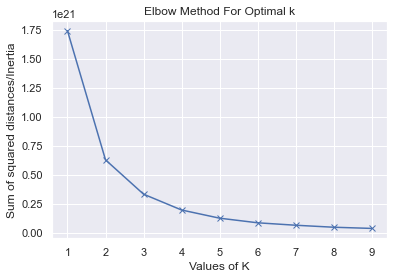

In [26]:
Sum_of_squared_distances = []
K = range(1, 10)
for num_clusters in K :
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(articles)
    Sum_of_squared_distances.append(kmeans.inertia_)
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

In [27]:
# elbow looks like around 4
# It was 12 in an an earlier version!
kmeans_float = KMeans(n_clusters=4)
kmeans_fit = kmeans_float.fit(articles)

In [28]:
print("labels:")
print(kmeans_float.labels_)
print("cluster_centers:")
print(kmeans_float.cluster_centers_)

labels:
[0 0 0 ... 1 1 1]
cluster_centers:
[[3.67250421e+08 3.67250402e+05 2.29258495e+04 2.35226763e+02
  8.15666584e+01 7.43109893e+00 1.00950993e+06 1.78998256e+01
  3.33498629e+01 1.66728134e+01 3.24595066e+00 2.09668577e+00
  7.86219786e+00 6.71218540e+00 5.08430077e+03 1.18081236e+02
  3.71791677e+00 4.99426863e+00 3.57762273e+00 1.54597558e+00
  4.84552704e+01 2.50595564e+01 1.01167680e+03 8.66284575e+00
  1.61402442e+02]
 [8.44853150e+08 8.44853147e+05 2.26370935e+04 2.33332586e+02
  7.00214729e+01 6.62482539e+00 1.01001295e+06 1.73586395e+01
  2.94546990e+01 1.71236397e+01 3.09112172e+00 2.14365072e+00
  7.89169347e+00 6.76457785e+00 4.20739980e+03 1.17567554e+02
  3.13601663e+00 4.63070526e+00 2.93402203e+00 1.39996102e+00
  4.13536692e+01 2.99791443e+01 1.01045051e+03 7.90985284e+00
  2.59312997e+02]
 [5.80083080e+08 5.80083073e+05 2.38041528e+04 2.38730393e+02
  7.59508170e+01 7.38158528e+00 1.00949401e+06 1.71419628e+01
  3.46871168e+01 1.67702976e+01 3.29037850e+00 2.0208

In [29]:
kmeans_float.fit_predict(articles)

array([3, 3, 3, ..., 0, 0, 0], dtype=int32)

In [30]:
labels = kmeans_float.labels_
#Glue back to originaal data
articles['clusters'] = labels

In [31]:
articles.clusters.value_counts()

2    39579
1    31088
0    30868
3     4007
Name: clusters, dtype: int64

In [32]:
articles.tail()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct,clusters
105537,953450001.0,953450.0,796,302.0,95,13,1010014.0,22,9.0,1,...,4,8,3.0,3,26.0,38,1021.0,13,16.0,0
105538,953763001.0,953763.0,37624,253.0,121,7,1010016.0,25,9.0,1,...,0,6,1.0,2,2.0,18,1005.0,6,34.0,0
105539,956217002.0,956217.0,8256,265.0,32,5,1010016.0,25,9.0,1,...,0,6,1.0,2,18.0,53,1005.0,6,21.0,0
105540,957375001.0,957375.0,6953,72.0,45,0,1010016.0,25,9.0,1,...,3,4,2.0,1,52.0,9,1019.0,0,0.0,0
105541,959461001.0,959461.0,25218,265.0,32,5,1010016.0,25,11.0,29,...,0,6,1.0,2,18.0,53,1005.0,6,0.0,0


In [33]:
# Check clustering
articles[articles['clusters']==0] 

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct,clusters
74674,777762001.0,777762.0,11848,259.0,86,7,1010023.0,7,72.0,2,...,4,8,3.0,3,21.0,5,1011.0,9,10.0,0
74675,777785001.0,777785.0,43244,255.0,105,7,1010014.0,22,10.0,47,...,7,2,4.0,0,47.0,54,1005.0,6,1.0,0
74676,777800002.0,777800.0,12059,259.0,86,7,1010004.0,4,73.0,5,...,4,8,3.0,3,21.0,5,1011.0,9,89.0,0
74677,777801001.0,777801.0,12476,254.0,108,7,1010009.0,11,51.0,24,...,5,0,4.0,0,44.0,1,1019.0,0,0.0,0
74678,777801002.0,777801.0,12476,254.0,108,7,1010009.0,11,9.0,1,...,5,0,4.0,0,44.0,1,1019.0,0,2.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105537,953450001.0,953450.0,796,302.0,95,13,1010014.0,22,9.0,1,...,4,8,3.0,3,26.0,38,1021.0,13,16.0,0
105538,953763001.0,953763.0,37624,253.0,121,7,1010016.0,25,9.0,1,...,0,6,1.0,2,2.0,18,1005.0,6,34.0,0
105539,956217002.0,956217.0,8256,265.0,32,5,1010016.0,25,9.0,1,...,0,6,1.0,2,18.0,53,1005.0,6,21.0,0
105540,957375001.0,957375.0,6953,72.0,45,0,1010016.0,25,9.0,1,...,3,4,2.0,1,52.0,9,1019.0,0,0.0,0


In [34]:
#create a new table for merging customer data
cluster_t = articles[['article_id','clusters']]
cluster_t

,article_id,clusters
0,108775015.0,3
1,108775044.0,3
2,108775051.0,3
3,110065001.0,3
4,110065002.0,3
...,...,...
105537,953450001.0,0
105538,953763001.0,0
105539,956217002.0,0
105540,957375001.0,0


In [35]:
#pca
pca = PCA(n_components=3)
articles_reduced = pca.fit_transform(articles)
articles_reduced

array([[ 5.89649849e+08, -1.19303554e+03, -1.60256729e+04],
       [ 5.89649820e+08, -1.19306900e+03, -1.60258886e+04],
       [ 5.89649813e+08, -1.19401597e+03, -1.60266103e+04],
       ...,
       [-2.57792562e+08, -2.57361014e+02,  1.42873457e+04],
       [-2.58950561e+08, -2.66403958e+02,  1.55919606e+04],
       [-2.61036562e+08, -1.15022650e+02, -2.68243551e+03]])

In [36]:
#plot
fig=px.scatter_3d(articles_reduced,x=0,y=1,z=2,color=labels)
fig.show()

# Prediction

In [37]:
customers

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,NaN,NaN,ACTIVE,NONE,49.0,52043ee2162cf5aa7ee79974281641c6f11a68d276429a...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,NaN,NaN,ACTIVE,NONE,25.0,2973abc54daa8a5f8ccfe9362140c63247c5eee03f1d93...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,NaN,NaN,ACTIVE,NONE,24.0,64f17e6a330a85798e4998f62d0930d14db8db1c054af6...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,NaN,NaN,ACTIVE,NONE,54.0,5d36574f52495e81f019b680c843c443bd343d5ca5b1c2...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,1.0,1.0,ACTIVE,Regularly,52.0,25fa5ddee9aac01b35208d01736e57942317d756b32ddd...
...,...,...,...,...,...,...,...
1371975,ffffbbf78b6eaac697a8a5dfbfd2bfa8113ee5b403e474...,NaN,NaN,ACTIVE,NONE,24.0,7aa399f7e669990daba2d92c577b52237380662f36480b...
1371976,ffffcd5046a6143d29a04fb8c424ce494a76e5cdf4fab5...,NaN,NaN,ACTIVE,NONE,21.0,3f47f1279beb72215f4de557d950e0bfa73789d24acb5e...
1371977,ffffcf35913a0bee60e8741cb2b4e78b8a98ee5ff2e6a1...,1.0,1.0,ACTIVE,Regularly,21.0,4563fc79215672cd6a863f2b4bf56b8f898f2d96ed590e...
1371978,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,1.0,1.0,ACTIVE,Regularly,18.0,8892c18e9bc3dca6aa4000cb8094fc4b51ee8db2ed14d7...


In [38]:
customers.head(10)

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,NaN,NaN,ACTIVE,NONE,49.0,52043ee2162cf5aa7ee79974281641c6f11a68d276429a...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,NaN,NaN,ACTIVE,NONE,25.0,2973abc54daa8a5f8ccfe9362140c63247c5eee03f1d93...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,NaN,NaN,ACTIVE,NONE,24.0,64f17e6a330a85798e4998f62d0930d14db8db1c054af6...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,NaN,NaN,ACTIVE,NONE,54.0,5d36574f52495e81f019b680c843c443bd343d5ca5b1c2...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,1.0,1.0,ACTIVE,Regularly,52.0,25fa5ddee9aac01b35208d01736e57942317d756b32ddd...
5,000064249685c11552da43ef22a5030f35a147f723d5b0...,NaN,NaN,NaN,NaN,NaN,2c29ae653a9282cce4151bd87643c907644e09541abc28...
6,0000757967448a6cb83efb3ea7a3fb9d418ac7adf2379d...,NaN,NaN,ACTIVE,NONE,20.0,fe7b8e2b3fafb89ca90db17ffeeae0fd29b795d803f749...
7,00007d2de826758b65a93dd24ce629ed66842531df6699...,1.0,1.0,ACTIVE,Regularly,32.0,8d6f45050876d059c830a0fe63f1a4c022de279bb68ce3...
8,00007e8d4e54114b5b2a9b51586325a8d0fa74ea23ef77...,NaN,NaN,ACTIVE,NONE,20.0,2c29ae653a9282cce4151bd87643c907644e09541abc28...
9,00008469a21b50b3d147c97135e25b4201a8c58997f787...,NaN,NaN,ACTIVE,NONE,20.0,2c29ae653a9282cce4151bd87643c907644e09541abc28...


In [39]:
tmp=transtrain_n[['customer_id','article_id','price','sales_channel_id']]

In [40]:
customers_n=customers.merge(tmp,on=['customer_id'],how='left')

In [41]:
customers_n=customers_n.merge(cluster_t,on=['article_id'],how='right')

In [42]:
customers_n.head()

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code,article_id,price,sales_channel_id,clusters
0,026915231e8234700d38e56f63a6dc1c48aa3c26fed0f1...,NaN,NaN,ACTIVE,NONE,34.0,9b236d6c9f9ad4fd4c2201d165105f55039d58515efc45...,108775015.0,0.007610,2.0,3
1,04111f3d5ec17ef2947ec121dc299f3c0e4cc3e739442a...,NaN,NaN,ACTIVE,NONE,24.0,9c97ecf98c5459ba14d18c0463731b92809fbc94b69d98...,108775015.0,0.008458,2.0,3
2,063200a071da420fba5fe142308dff303adae2064c5d0a...,1.0,1.0,ACTIVE,Regularly,48.0,d9fb8bb338626b327cee46076996774b6f7ade1135ba01...,108775015.0,0.008203,1.0,3
3,0a80c22bd97560c61d120ddc2814db6f065953fcc58846...,1.0,1.0,ACTIVE,Regularly,30.0,bb78e0675aa5a62b338ee097c40d1f3f5437e59cb4e509...,108775015.0,0.008458,2.0,3
4,0cd161c4a2b49a02dcef5b876698cdd064ebf3e16347c4...,NaN,NaN,ACTIVE,NONE,28.0,9ec31f9af035d548036e96d52a6b3e1d75b34dc97b4644...,108775015.0,0.008458,2.0,3


In [43]:
customers_n.isnull().sum()

customer_id                 34673
FN                        7319062
Active                    7399180
club_member_status          56906
fashion_news_frequency      97827
age                         85181
postal_code                 34673
article_id                      0
price                       34673
sales_channel_id            34673
clusters                        0
dtype: int64

In [44]:
customers_n=customers_n.drop(['customer_id','postal_code'], axis=1)

In [45]:
customers_n=customers_n.drop(['article_id'], axis=1)

In [46]:
customers_n['FN'] = customers_n['FN'].fillna(0)
customers_n['Active'] = customers_n['Active'].fillna(0)
customers_n['fashion_news_frequency'] = customers_n['fashion_news_frequency'].fillna('NONE')
customers_n['age'] = customers_n['age'].fillna(customers_n['age'].median())
customers_n['club_member_status'] = customers_n['club_member_status'].fillna('None')
# customers_n['ct'] = customers_n['ct'].fillna(0)
customers_n['price'] = customers_n['price'].fillna(customers_n['price'].median())
customers_n['sales_channel_id'] = customers_n['sales_channel_id'].fillna(customers_n['sales_channel_id'].median())

In [47]:
customers_n.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,clusters
0,0.0,0.0,ACTIVE,NONE,34.0,0.007610,2.0,3
1,0.0,0.0,ACTIVE,NONE,24.0,0.008458,2.0,3
2,1.0,1.0,ACTIVE,Regularly,48.0,0.008203,1.0,3
3,1.0,1.0,ACTIVE,Regularly,30.0,0.008458,2.0,3
4,0.0,0.0,ACTIVE,NONE,28.0,0.008458,2.0,3


In [48]:
le = preprocessing.LabelEncoder()

# fit label encorder and return encoded integer labels for categorical string features
customers_n['club_member_status'] = le.fit_transform(customers_n['club_member_status'].values)
customers_n['fashion_news_frequency'] = le.fit_transform(customers_n['fashion_news_frequency'].values)

In [49]:
customers_n.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,clusters
0,0.0,0.0,0,1,34.0,0.007610,2.0,3
1,0.0,0.0,0,1,24.0,0.008458,2.0,3
2,1.0,1.0,0,3,48.0,0.008203,1.0,3
3,1.0,1.0,0,3,30.0,0.008458,2.0,3
4,0.0,0.0,0,1,28.0,0.008458,2.0,3


# Train and Test

After clustering the articles, we are aiming to build a model where it predicts, through a customer's attributes, what cluster of articles they would most likely be most interested in. This aims to push personalized shopping to customers. By identifying the specific cluster of items a person might be interested in, H&M can showcase those items on the first page to them as they open their website. This increases the chances of a customer running into items that they are interested in and in turn will increase the probability of them making a purchase. Hence, in this classification problem, we are using variables in the customer data as predictors, and cluster group as the outcome variable. The train data consists of transaction data that contains customer_id and the article that they bought, and the article_id has been used to match the clusters to their respective articles, adding a column that assigns each customer to cluster group.

In [50]:
customers_n.count()

FN                        12912828
Active                    12912828
club_member_status        12912828
fashion_news_frequency    12912828
age                       12912828
price                     12912828
sales_channel_id          12912828
clusters                  12912828
dtype: int64

In [51]:
# we decided to randomly select 10% of data which is 645641 records, because the data is too big 
# and it was taking too much time to run the models
df1 = customers_n.sample(frac = 0.05)
df1.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,clusters
6272492,0.0,0.0,3,1,31.0,0.067780,2.0,0
9669447,1.0,1.0,0,3,47.0,0.011847,2.0,0
8695755,0.0,0.0,0,1,22.0,0.025407,2.0,0
11765303,0.0,0.0,0,1,29.0,0.008458,2.0,0
11463620,0.0,0.0,0,1,23.0,0.042356,2.0,0


In [52]:
df1.count()

FN                        645641
Active                    645641
club_member_status        645641
fashion_news_frequency    645641
age                       645641
price                     645641
sales_channel_id          645641
clusters                  645641
dtype: int64

In [53]:
#Splitting data into training and testing

In [54]:
X, y = df1.drop(['clusters'], axis = 1), df1['clusters']

In [55]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, test_size=0.2, random_state = 1, shuffle = True)

In [56]:
X

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id
6272492,0.0,0.0,3,1,31.0,0.067780,2.0
9669447,1.0,1.0,0,3,47.0,0.011847,2.0
8695755,0.0,0.0,0,1,22.0,0.025407,2.0
11765303,0.0,0.0,0,1,29.0,0.008458,2.0
11463620,0.0,0.0,0,1,23.0,0.042356,2.0
...,...,...,...,...,...,...,...
7253972,1.0,1.0,0,3,23.0,0.016932,2.0
5441607,0.0,0.0,0,1,31.0,0.008458,2.0
3270880,0.0,0.0,0,1,28.0,0.016932,1.0
7274941,1.0,1.0,0,3,26.0,0.015237,2.0


In [57]:
y

6272492     0
9669447     0
8695755     0
11765303    0
11463620    0
           ..
7253972     0
5441607     2
3270880     2
7274941     0
2852044     2
Name: clusters, Length: 645641, dtype: int32

In [58]:
#decision_tree
decision_tree = DecisionTreeClassifier()
decision_tree.fit(X_train, y_train)
Y_pred_dt = decision_tree.predict(X_test)
acc_decision_tree = round(decision_tree.score(X_test, y_test) * 100, 3)
print(str(acc_decision_tree))

# Compute MSE
mse_test = MSE(y_test, Y_pred_dt)
# Compute RMSE
rmse_test_dt = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_dt))

52.405
Test set RMSE of gb: 1.299


In [59]:
#random forest (classification, regression)
clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)
y_ran_forest_pred = clf.predict(X_test)
acc_ran_forest = round(clf.score(X_test, y_test)*100, 3)
print(str(acc_ran_forest))

mse_test = MSE(y_test, y_ran_forest_pred)
# Compute RMSE
rmse_test_rf = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_rf))

52.367
Test set RMSE of gb: 1.299


In [60]:
#KNN (classification, regression)
knn = KNeighborsClassifier(n_neighbors = 3)
knn.fit(X_train, y_train)
Y_pred_knn = knn.predict(X_test)
acc_knn = round(knn.score(X_test, y_test) * 100, 3)
print(str(acc_knn))

mse_test = MSE(y_test, Y_pred_knn)
# Compute RMSE
rmse_test_knn = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_knn))

47.988
Test set RMSE of gb: 1.338


In [61]:
#SVC (classification, regression )
linear_svc = LinearSVC()
linear_svc.fit(X_train, y_train)
Y_pred_svc = linear_svc.predict(X_test)
acc_linear_svc = round(linear_svc.score(X_test, y_test) * 100, 3)
print(str(acc_linear_svc))

# Compute MSE
mse_test = MSE(y_test, Y_pred_svc)
# Compute RMSE
rmse_test_svc = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_svc))

48.742
Test set RMSE of gb: 1.260


In [62]:
#Gaussian Naive Bayes (continuos)
gaussian = GaussianNB()
gaussian.fit(X_train, y_train)
Y_pred_gaussian = gaussian.predict(X_test)
acc_gaussian = round(gaussian.score(X_test, y_test) * 100, 3)
print(str(acc_gaussian))

# Compute MSE
mse_test = MSE(y_test, Y_pred_gaussian)
# Compute RMSE
rmse_test_gaussian = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_gaussian))

53.373
Test set RMSE of gb: 1.305


In [63]:
#Perceptron (binary)
perceptron = Perceptron(max_iter=5)
perceptron.fit(X_train, y_train)
Y_pred_perceptron = perceptron.predict(X_test)
acc_perceptron = round(perceptron.score(X_test, y_test) * 100, 3)
print(str(acc_perceptron))

mse_test = MSE(y_test, Y_pred_perceptron)
# Compute RMSE
rmse_test_perceptron = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_perceptron))

53.888
Test set RMSE of gb: 1.312


In [64]:
#Stochastic Gradient Descent (SGD)(linear classifiers and regressors)
sgd = SGDClassifier(max_iter=5, tol=None)
sgd.fit(X_train, y_train)
Y_pred_sgd = sgd.predict(X_test)
sgd.score(X_test, y_test)
acc_sgd = round(sgd.score(X_test, y_test) * 100, 3)
print(str(acc_sgd))

mse_test = MSE(y_test, Y_pred_sgd)
# Compute RMSE
rmse_test_sgd = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_sgd))

53.866
Test set RMSE of gb: 1.312


In [65]:
# Define Gradient Boosting Classifier with hyperparameters
gbc=GradientBoostingClassifier(n_estimators=500,learning_rate=0.05,random_state=1,max_features=5 )
# Fit train data to GBC
gbc.fit(X_train,y_train)
acc_gbc = accuracy_score( 
     y_test, gbc.predict(X_test))
acc_gbcl = round(acc_gbc * 100, 3)
print(acc_gbcl)

Y_pred_gbc = gbc.predict(X_test)
mse_test = MSE(y_test, Y_pred_gbc)
# Compute RMSE
rmse_test_gbc = mse_test**(1/2)
# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test_gbc))

54.871
Test set RMSE of gb: 1.283


In [69]:
# Putting all used ML algorithms in the table
results = pd.DataFrame({
    'Model': ['Gradient Boosting Classifier', 'Linear Support Vector Classification', 'KNN', 
              'Random Forest', 'Naive Bayes', 'Perceptron', 
              'Stochastic Gradient Decent', 
              'Decision Tree'],
    'Accuracy Score': [ acc_gbcl, acc_linear_svc, acc_knn, 
              acc_ran_forest, acc_gaussian, acc_perceptron, 
              acc_sgd, acc_decision_tree],
    'RMSE':  [rmse_test_gbc,rmse_test_svc, rmse_test_knn, rmse_test_rf, rmse_test_gaussian,
              rmse_test_perceptron, rmse_test_sgd, rmse_test_dt]})
result_df = results.sort_values(by='Accuracy Score', ascending=False)
result_df = result_df.set_index('Model')
result_df.head(9)

,Accuracy Score,RMSE
Model,,
Gradient Boosting Classifier,54.871,1.283115
Perceptron,53.888,1.312217
Stochastic Gradient Decent,53.866,1.311910
Naive Bayes,53.373,1.305460
Decision Tree,52.405,1.298611
Random Forest,52.367,1.299324
Linear Support Vector Classification,48.742,1.260337
KNN,47.988,1.337843


We have implemented 8 classification models to our data and found out that Gradient Boosting Classifier yielded the best accuracy out of every other model. It outperforms Logistic Regression, Perceptron, Linear SVC, and Naive Bayes with 54.9% accuracy compared to average 53.5%. We believe that almost all models lie in this range of accuracy due to the lack of variance and attributes in customer data.